### Notes & Imports

In [ ]:
# tbd
    # spatial correlations -> variograms
        # if sampling random -> based on point measurements
        # else based on spectral values (NDVI, etc)
    # srcs
        # https://scikit-gstat.readthedocs.io/en/latest/userguide/variogram.html
        # https://geostat-framework.readthedocs.io/projects/pykrige/en/latest/examples/07_regression_kriging2d.html#sphx-glr-examples-07-regression-kriging2d-py

# observations from QGIS
    # eastern sites pretty similar to each other -> low veg heights & max mediocre veg covers
    # La Plagne site differs in that it shows higher vegetation amounts (heights & coverage) overall
    # spatial dependencies in terms of correlation patterns on different scales existent - despite considered scale of 1m
        #  on intra-site level on a scale of at least 10m -> patches of vegetation vs. rocks
        #  across sites considering the elevation

# taking into account additional variables to constrain the network
    # spatial relationships on middle-level
    # DEMs on higher level -> too few sampling points?!

In [ ]:
# note that at the moment masking invalid pixels is implemented in a rather simple way by excluding every patch with more than 1% pixels with zeros in all channels
# more elaborated definitions of mask e.g. via segmentation possible

# ideas of applying rescaling/contrast stretching
    # no need for post-processing for vis
    # transferability to other data sets & sun light conditions
    # normalisation per site seems reasonable - homogenous image acquisition conditions per site
    # normalisation per band necessary as sensor has larger sensitivity in green than other bands

In [2]:
# general imports
import contextlib
import glob
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os 
import rasterio
import rasterio.mask
import rasterio.plot as rp
import seaborn as sns
import shutil
from osgeo import gdal
from patch_creator import Generator
from skimage import exposure
from tqdm import tqdm

# enforce reload of modules
%load_ext autoreload
%autoreload 2

In [82]:
# plotting settings
plt.style.use('default')

In [3]:
# def params
sites = ["Bocard", "Chichoue_Bas", "Chichoue_Milieu_Bas", "Chichoue_Haut", "Chichoue_Milieu_Haut", "La_Plagne"]
tile_size_m = 1 # tile size in m
tile_ovlp = 0.5 # overlap in %, if more training data necessary increase overlap up to max. 0.5
masking_thres = 0.005 # percentage of invalid/nan pixels to exclude tiles from further consideration
rescale=True # perform band-wise and site-wise histogram stretching

# data paths
# reading data
read_dir = "E:/biomass_pyrenees/sixp/data"
def get_vrt_dir(site): 
    return os.path.join(read_dir, site, "ortho_vnir.vrt")

# writing data
write_dir = "C:/Users/felix/Desktop/internship_letg/data/biomass"
os.chdir(write_dir)

# writing dirs for AE tiles
def all_tiles_dir(site): 
    return os.path.join(write_dir, "all_tiles", site)

train_ae = os.path.join(os.path.dirname(all_tiles_dir("")), "train")
val_ae = os.path.join(os.path.dirname(all_tiles_dir("")), "val")
test_ae = os.path.join(os.path.dirname(all_tiles_dir("")), "test")

# writing path for vrt overviews
def all_tiles_vrt(site): 
    return os.path.join(write_dir, "all_tiles", f'{site}.vrt')

# writing dir for point tiles
point_tiles_dir = os.path.join(write_dir, "point_tiles")

fig_dir = "C:/Users/felix/Desktop/internship_letg/figures"
# note: all parent folders have to be existent
# only site specific subfolders & train/val/test are created automatically

In [4]:
# helper functions
def plot_tiles(img_path, rescale_stats=None, vis="rgb"):
    # read data
    src = rasterio.open(img_path)
    img_trans = np.transpose(src.read(), (1,2,0))

    # contrast stretching
    contrast_perc = 0
    for channel in range(0,img_trans.shape[2]):
        if rescale_stats is None:
            pass
        elif rescale_stats == "stretch":
            pu, po = np.percentile(img_trans[...,channel], (0.1, 99.9))
            img_trans[...,channel] = exposure.rescale_intensity(img_trans[...,channel], in_range=(pu, po))
    
    # return img
    if vis=="rgb":
        img = rp.adjust_band(np.transpose(img_trans, (2,0,1)))[:3,:,:]
    if vis=="nir":
        img_ = rp.adjust_band(np.transpose(img_trans, (2,0,1)))[1:4,:,:]
        img = np.copy(img_)
        img[0,:,:], img[2,:,:] = img_[2,:,:], img_[0,:,:]
    return img

### Part Ia: Image Tiling (-> AE preprocessing)

In [4]:
for site in sites:
    print(f"--- Site: {site} ---")
    vrt_dir = get_vrt_dir(site)
    patch_dir = all_tiles_dir(site)

    # generate patches
    patch = Generator(
        image=vrt_dir, 
        patch_size=tile_size_m, 
        stride=tile_ovlp, 
        channel_first=True,
        out_res=0.003
        )

    # get basic info on patches
    # patch.data_dimension()
    # patch.patch_info()

    # save patches as gtiff
    patch.save_Geotif(
        folder_name=patch_dir,
        eval_mask=True, 
        mask_val=0, 
        thres=masking_thres,
        rescale=rescale
    )
    print(f"-------------------\n")

--- Site: Bocard ---
Resampling will be applied as desired resolution doesn't match the resolution of the input data
Input resolution: 0.002
Output resolution: 0.003

Reading & Resampling the data...
Performing contrast stretching...
Start patching...


Patch Counter: 100%|██████████| 42244/42244 [01:59<00:00, 353.55 Patch/s] 


Masking tiles with more than 0.5% invalid values reduced amount of created patches.
4779 patches are saved as ".tif" format in "C:/Users/felix/Desktop/internship_letg/data/biomass\all_tiles\Bocard"

-------------------

--- Site: Chichoue_Bas ---
Reading the data...
Performing contrast stretching...
Start patching...


Patch Counter: 100%|█████████▉| 31638/31641 [02:11<00:00, 1108.63 Patch/s]

Masking tiles with more than 0.5% invalid values reduced amount of created patches.


Patch Counter: 100%|██████████| 31641/31641 [02:12<00:00, 239.36 Patch/s] 

7786 patches are saved as ".tif" format in "C:/Users/felix/Desktop/internship_letg/data/biomass\all_tiles\Chichoue_Bas"

-------------------

--- Site: Chichoue_Milieu_Bas ---


Resampling will be applied as desired resolution doesn't match the resolution of the input data
Input resolution: 0.002
Output resolution: 0.003

Reading & Resampling the data...
Performing contrast stretching...
Start patching...


Patch Counter: 100%|██████████| 13924/13924 [00:30<00:00, 457.52 Patch/s] 


Masking tiles with more than 0.5% invalid values reduced amount of created patches.
3603 patches are saved as ".tif" format in "C:/Users/felix/Desktop/internship_letg/data/biomass\all_tiles\Chichoue_Milieu_Bas"

-------------------

--- Site: Chichoue_Haut ---
Resampling will be applied as desired resolution doesn't match the resolution of the input data
Input resolution: 0.002
Output resolution: 0.003

Reading & Resampling the data...
Performing contrast stretching...
Start patching...


Patch Counter: 100%|█████████▉| 18623/18644 [02:17<00:00, 1212.55 Patch/s]

Masking tiles with more than 0.5% invalid values reduced amount of created patches.


Patch Counter: 100%|██████████| 18644/18644 [02:17<00:00, 135.31 Patch/s] 

6454 patches are saved as ".tif" format in "C:/Users/felix/Desktop/internship_letg/data/biomass\all_tiles\Chichoue_Haut"

-------------------

--- Site: Chichoue_Milieu_Haut ---


Resampling will be applied as desired resolution doesn't match the resolution of the input data
Input resolution: 0.002
Output resolution: 0.003

Reading & Resampling the data...
Performing contrast stretching...
Start patching...


Patch Counter: 100%|██████████| 24964/24964 [02:05<00:00, 199.08 Patch/s] 


Masking tiles with more than 0.5% invalid values reduced amount of created patches.
9167 patches are saved as ".tif" format in "C:/Users/felix/Desktop/internship_letg/data/biomass\all_tiles\Chichoue_Milieu_Haut"

-------------------

--- Site: La_Plagne ---
Resampling will be applied as desired resolution doesn't match the resolution of the input data
Input resolution: 0.002
Output resolution: 0.003

Reading & Resampling the data...
Performing contrast stretching...
Start patching...


Patch Counter: 100%|██████████| 31284/31284 [04:11<00:00, 124.37 Patch/s] 


Masking tiles with more than 0.5% invalid values reduced amount of created patches.
9625 patches are saved as ".tif" format in "C:/Users/felix/Desktop/internship_letg/data/biomass\all_tiles\La_Plagne"

-------------------



In [5]:
# number of patches
tiles_total = 0
for site in sites:
    n_tiles = len(os.listdir(all_tiles_dir(site)))
    tiles_total += n_tiles
    print(f"Number of Tiles: {n_tiles} ({site})")
print(f"Total number of tiles: {tiles_total}")

Number of Tiles: 4779 (Bocard)
Number of Tiles: 7786 (Chichoue_Bas)
Number of Tiles: 3603 (Chichoue_Milieu_Bas)
Number of Tiles: 6454 (Chichoue_Haut)
Number of Tiles: 9167 (Chichoue_Milieu_Haut)
Number of Tiles: 9625 (La_Plagne)
Total number of tiles: 41414


In [6]:
# create comprehensive raster for visualisation
for site in sites:
    patch_dir = all_tiles_dir(site)
    site_patches = [os.path.join(patch_dir, x) for x in os.listdir(patch_dir)]
    vrt_out_dir = all_tiles_vrt(site)
    # built vrt
    vrt = gdal.BuildVRT(
        vrt_out_dir, 
        site_patches
        )
    vrt.FlushCache()
    # built pyramids on datasets
    ds = None
    ds = gdal.Open(vrt_out_dir)
    factors = [8, 16, 32, 64, 128, 256]
    gdal.SetConfigOption('COMPRESS_OVERVIEW', 'DEFLATE')
    ds.BuildOverviews("AVERAGE", factors)
    # status update
    print(f"VRT & Pyramids built for site: {site}")

VRT & Pyramids built for site: Bocard
VRT & Pyramids built for site: Chichoue_Bas
VRT & Pyramids built for site: Chichoue_Milieu_Bas
VRT & Pyramids built for site: Chichoue_Haut
VRT & Pyramids built for site: Chichoue_Milieu_Haut
VRT & Pyramids built for site: La_Plagne


In [8]:
# # determine lower/upper percentiles across tiles for rescaling
# # useful for explorative analyses if rescaling=False in patching above

# for idx, site in tqdm(enumerate(sites)):
#     vrt_out_dir = all_tiles_vrt(site)
#     rast = rasterio.open(vrt_out_dir).read()

#     single_site = np.zeros((2,4)) 
#     for band in range(0, rast.shape[0]):
#         single_site[0,band] = np.percentile(rast[band,:,:], 1)
#         single_site[1,band] = np.percentile(rast[band,:,:], 99)

#     if idx == 0:
#         stats_across_sites = single_site
#     else:
#         stats_across_sites[0,:] = np.where(single_site[0,:]<stats_across_sites[0,:], single_site[0,:], stats_across_sites[0,:])
#         stats_across_sites[1,:] = np.where(single_site[1,:]>stats_across_sites[1,:], single_site[1,:], stats_across_sites[1,:])

# stats_across_sites

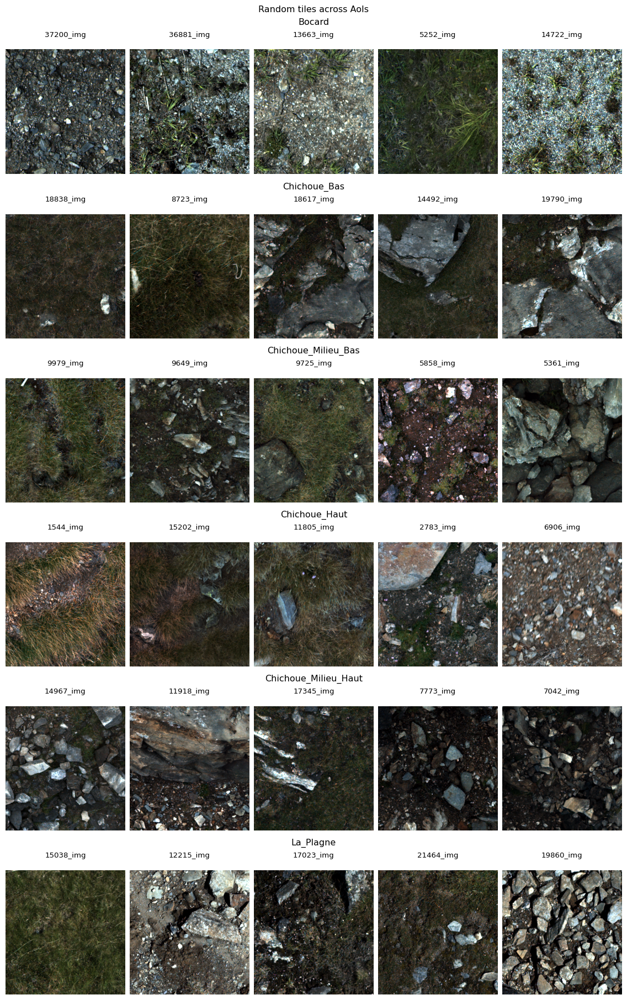

In [16]:
# visualise patches
sns.set_context("paper")
def plot_multiple_patches(out_name = None, show = False, rescale_stats=None):
    n_examples = 5
    fig = plt.figure(figsize=(2.25*n_examples,18), constrained_layout=True)
    fig.suptitle('Random tiles across AoIs')
    subfigs = fig.subfigures(nrows=len(sites), ncols=1)

    # subfigure row per vegetation height interval
    for row, subfig in enumerate(subfigs):
        subfig.suptitle(f'{sites[row]}')
        site = sites[row]
        
        # get image paths
        patch_dir = all_tiles_dir(site)
        np.random.seed(123)
        rand_n = np.random.randint(len(os.listdir(patch_dir)), size=n_examples)
        tile_paths = [os.path.join(patch_dir, os.listdir(patch_dir)[idx]) for idx in rand_n]

        # plot examples
        axs = subfig.subplots(nrows=1, ncols=n_examples)
        for col, ax in enumerate(axs):
            # get imagery
            rgb = plot_tiles(tile_paths[col], rescale_stats)
            ax.imshow(np.transpose(rgb, (1,2,0)), aspect="auto")
            # adjust title
            site = os.path.split(tile_paths[col])[-1].split(".tif")[0]
            ax.set_title(f"{site}\n")
            ax.set_axis_off()

    if out_name is not None:
        fig.savefig(os.path.join(fig_dir, out_name))

    if show:
        plt.show();
    else:
        plt.close();

# plot_multiple_patches("tiles_v2_without_optim.png", show=True)
# plot_multiple_patches("tiles_v2_streched_each.png", rescale_stats="stretch")

plot_multiple_patches(show=True)

### Part Ib: Exporative analses on UAV data

In [8]:
# variability of spectral values
# more detailed overview via flattening & fast-histogram possible

def site_stats(site):
    # read raster for site
    vrt_out_dir = os.path.join(write_dir, "all_tiles", f'{site}.vrt')
    rast = rasterio.open(vrt_out_dir).read()
    # draw sample
    s_size = 10000
    sample = rast[
        :,
        np.random.choice(np.arange(rast.shape[1]), size=s_size),
        np.random.choice(np.arange(rast.shape[2]), size=s_size)
    ]
    # mask out na values
    arr_mask = np.broadcast_to(sample.sum(axis=0) == 0, sample.shape)
    arr_masked = np.ma.array(sample, mask=arr_mask)
    # calculate stats
    means = list(arr_masked.mean(axis=1))
    sds = list(arr_masked.std(axis=1))
    # return stats
    per_site = {}
    bands = ["r", "g", "b", "nir"]
    [per_site.update([(f"mean_{band}", val)]) for band,val in zip(bands, means)]
    [per_site.update([(f"sd_{band}", val)]) for band,val in zip(bands, sds)]
    return per_site

spec_vals = {}
for site in sites:
    stats = site_stats(site)
    spec_vals.update([(site, stats)])

In [9]:
spec_df = pd.DataFrame(spec_vals).round(2).reset_index()
spec_df[["stat", "band"]] = spec_df["index"].str.split("_", expand=True)
spec_df.drop(columns="index", inplace=True)
spec_df = spec_df[spec_df.columns.tolist()[-2:] + spec_df.columns.tolist()[:-2]]
spec_df

,stat,band,Bocard,Chichoue_Bas,Chichoue_Milieu_Bas,Chichoue_Haut,Chichoue_Milieu_Haut,La_Plagne
0,mean,r,15386.51,13455.14,15232.04,17096.76,12741.64,14196.38
1,mean,g,16902.55,13660.64,15346.16,17140.73,12486.34,14453.12
2,mean,b,14277.46,11446.29,12615.34,15623.59,11342.12,11270.16
3,mean,nir,16293.22,33522.33,27630.12,24504.15,21886.40,31086.47
4,sd,r,14116.02,9489.91,8896.09,10026.36,8925.26,10314.65
5,sd,g,14248.21,8947.43,8469.74,10102.20,8819.35,9639.05
6,sd,b,13818.87,9470.72,8535.08,10322.89,9039.72,9864.28
7,sd,nir,12177.67,11801.17,13928.96,13211.28,12605.98,14580.99


In [10]:
def draw_samples(x):
    return np.random.normal(x["mean"], x["sd"], 10000)

spec_plot = pd.melt(spec_df, id_vars=["stat", "band"], value_vars=spec_df.columns.tolist()[2:])
spec_plot = spec_plot.pivot_table(columns=["stat"], index=["band", "variable"], values="value").reset_index()
spec_plot["samples"] = spec_plot.apply(draw_samples, 1)
spec_plot = spec_plot.explode("samples").drop(columns="sd")

spec_plot["samples"] = spec_plot["samples"].astype("float")
spec_plot["variable"] = spec_plot["variable"].astype("category")
spec_plot["variable"] = spec_plot["variable"].cat.set_categories(sites)
spec_plot["band"] = spec_plot["band"].astype("category")
spec_plot["band"] = spec_plot["band"].cat.set_categories(["b", "g", "r", "nir"])

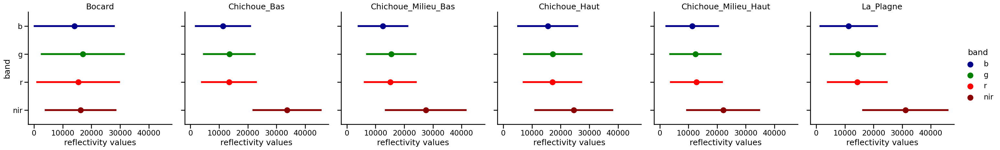

In [14]:
sns.set_context("talk")
fig = sns.catplot(
    x="samples", 
    y="band", 
    hue="band", 
    col ="variable", 
    kind="point", 
    ci="sd", 
    join=False,
    palette=["darkblue", "green", "red", "darkred"], 
    data=spec_plot);

for col in range(0,fig.axes.shape[1]):
    site = fig.axes[0][col].title.get_text().split("= ")[-1]
    fig.axes[0][col].set_title(f"{site}")
    fig.axes[0][col].set_xlabel(f"reflectivity values")

### Part Ic: Train-Val-Test split 

In [ ]:
# avoidance of overlap train-test-val datasets
# realised via monte carlo markov chain simulation / random walk
# leads to clustered but still randomly created portions of tiles for train-test-val
# maximises use of tiles while guaranteeing randomised selection of tiles

In [17]:
def overlap_tiles(tile_name, tiles_per_line, max_neigh_ovlp = np.ceil((1/(1-tile_ovlp)) - 1)):
    tile_num = int(tile_name.split("_img.tif")[0])
    neigh_ovlp = np.arange(0, max_neigh_ovlp+1)
    size_ovlp_matrix = np.power((2*len(neigh_ovlp) - 1), 2)
    size_sqrt = np.int_(np.sqrt(size_ovlp_matrix))
    min_val = -int(size_ovlp_matrix/2)
    max_val = int(size_ovlp_matrix/2)
    arr = np.array(np.arange(min_val, max_val + 1)).reshape(size_sqrt, size_sqrt).astype(complex)
    centre = (np.where(arr == 0)[0]).astype(int)
    for row in range(0,arr.shape[0]):
        for col in range(0,arr.shape[1]):
            arr[row, col] = complex((col-centre),(row-centre))
            ovlp_tile_num = tile_num + np.real(arr[row, col])
            ovlp_tile_num += np.imag(arr[row, col]) * n_tiles_line
            arr[row, col] = ovlp_tile_num
    ovlp_tiles = [f"{int(num)}_img.tif" for num in np.real(arr).flatten()]
    ovlp_tiles = [x for x in ovlp_tiles if x not in [tile_name]]
    return ovlp_tiles


def random_walk(all_tiles, prob, ovlp_tile_param):
    all_tiles_save = all_tiles
    idxs = range(0, len(all_tiles))
    tile_seq = []
    # set first tile
    next_tile = all_tiles[0]
    all_tiles = [x for x in all_tiles if x not in [next_tile]]
    tile_seq.append(next_tile)
    # random walk
    while len(all_tiles) > 0:
        current_tile = next_tile 
        stay = np.random.choice([0,1], p=[1-prob, prob])
        if stay:
            # two principles/aims
            neighbours = overlap_tiles(current_tile, ovlp_tile_param)
            # 1. select only existing neighbouring tiles
            neigh_existing = []
            for n in neighbours:
                if n in all_tiles_save:
                      neigh_existing.append(n)
            # 2. choose neighbours that havent been chosen first
            neigh_left = neigh_existing
            while len(neigh_left) != 0:
                next_tile = np.random.choice(neigh_left)
                if next_tile in tile_seq:
                    neigh_left = [x for x in neigh_left if x not in [next_tile]]
                else:
                    break
        else:
            next_tile = all_tiles[0]
        # final actions if tile is not in tile sequence so far
        if next_tile not in tile_seq:
            all_tiles = [x for x in all_tiles if x not in [next_tile]]
            tile_seq.append(next_tile)
            # evaluate if gaps/holes were created & fill them
            # note hard coded parameter here do not allow to choose a ovlp > 0.5
            n = overlap_tiles(next_tile, ovlp_tile_param, max_neigh_ovlp=2)
            nn = [overlap_tiles(x, ovlp_tile_param) for x in n]
            n_ovlps = [sum(el in x for el in tile_seq) for x in nn]
            gaps = [x for x,n_ov in zip(n, n_ovlps) if n_ov >= 4 and x not in tile_seq]
            if len(gaps):
                all_tiles = [x for x in all_tiles if x not in gaps]  
                for gap in gaps:
                    if gap in all_tiles_save:
                        tile_seq.append(gap)
    return list(tile_seq)


def split_non_overlapping(tiles, split_ratio, ovlp_tile_param):
    # save initial params
    tiles_ = tiles
    split_ratio_ = split_ratio
    # define intial split ratios as approx. estimates
    if np.isclose(np.array(split_ratio).sum(), 100):
        split_ratio = np.array(split_ratio).astype(float)
        test_rest_ratio = split_ratio[2]/(split_ratio[0] + split_ratio[1]) 
        val_train_ratio = split_ratio[1]/split_ratio[0]
    else:
        raise ValueError
    # refine split ratio iteratively to match specified one
    i = 0
    while i < 25:
        train = []
        test = []
        val = []
        ovlp_ls = []
        # all tiles remain for selection prior to start matching
        # first split (i.e. test vs. val+train)
        remaining = tiles_
        for t in tiles:
            while (len(test)/len(remaining)) < (test_rest_ratio):
                ovlp_tiles = [x for x in overlap_tiles(t, ovlp_tile_param) if x in tiles]
                excl = [x for x in tiles if x in ovlp_tiles]
                remaining = [x for x in remaining if x not in excl]
                test.append(t)
                break      
        # only non-overlapping tiles considered for next split (i.e val vs. train)
        tiles = remaining
        for t in tiles: 
            while (len(val)/len(remaining)) < (val_train_ratio):
                ovlp_tiles = [x for x in overlap_tiles(t, ovlp_tile_param) if x in tiles]
                excl = [x for x in tiles if x in ovlp_tiles]
                remaining = [x for x in remaining if x not in excl]
                val.append(t)
                break
        # remaining samples are training samples
        train.extend(remaining)
        # measure divergence for train-split ratio and optimise split if necessary
        n_total = len(train) + len(val) + len(test)
        train_p = len(train)/n_total*100
        val_p = len(val)/n_total*100
        test_p = len(test)/n_total*100
        diffs = np.array((
            train_p-split_ratio_[0],
            val_p-split_ratio_[1],
            test_p-split_ratio_[2],
        ))
        # evaluate difference
        if abs(diffs).sum() < 0.5:
            break
        # refine split ratios    
        if abs(diffs).sum() > 5:
            r_change = 1
        elif abs(diffs).sum() > 2.5:
            r_change = 0.5
        elif abs(diffs).sum() > 1:
            r_change = 0.1
        else:
            r_change = 0.05 
        if 2 not in set((np.argmax(diffs), np.argmin(diffs))):
            split_ratio[np.argmax(diffs)] = split_ratio[np.argmax(diffs)] - r_change
            split_ratio[np.argmin(diffs)] = split_ratio[np.argmin(diffs)] + r_change
            val_train_ratio = split_ratio[1]/split_ratio[0]
        else:
            split_ratio[np.argmax(diffs)] = split_ratio[np.argmax(diffs)] - r_change
            split_ratio[np.argmin(diffs)] = split_ratio[np.argmin(diffs)] + r_change
            test_rest_ratio = split_ratio[2]/(split_ratio[0] + split_ratio[1])
        # increase index    
        i += 1
        if i == 25:
            print("Warning: Desired Train-Val-Test ratio was not achieved!")

    print(f"Train samples: {len(train)}")
    print(f"Val samples: {len(val)}")
    print(f"Test samples: {len(test)}")
    print(f"--------------------------------")
    print(f"Train Val Test ratio: {len(train)/n_total:.0%}-{len(val)/n_total:.0%}-{len(test)/n_total:.0%}")
    print(f"Ratio of all pixels used: {n_total/len(tiles_):.1%}")

    return train, val, test


def save_tiles(site_prefix, train, val, test):
    for path in [train_ae, val_ae, test_ae]:
        fold = os.path.join(path, "uav")
        if not os.path.exists(fold):
            os.makedirs(fold)
    for tile in train:
        shutil.copy(
            os.path.join(all_tiles_dir(site_prefix), tile), 
            os.path.join(train_ae, "uav", f"{site_prefix}_{tile.split('_')[0]}.tif")
        )
    for tile in val:
        shutil.copy(
            os.path.join(all_tiles_dir(site_prefix), tile), 
            os.path.join(val_ae, "uav", f"{site_prefix}_{tile.split('_')[0]}.tif")
        )
    for tile in test:
        shutil.copy(
            os.path.join(all_tiles_dir(site_prefix), tile), 
            os.path.join(test_ae, "uav", f"{site_prefix}_{tile.split('_')[0]}.tif")
        )

In [18]:
training_sites = [s for s in sites if s not in ["Chichoue_Milieu_Bas"]]

for site in training_sites:                          
    # get paths
    vrt_orig = get_vrt_dir(site)
    vrt_new = all_tiles_vrt(site)
    first_tile = os.path.join(all_tiles_dir(site), os.listdir(all_tiles_dir(site))[0])
    # get metadata
    orig_res = rasterio.open(vrt_orig).meta["transform"][0]
    new_res = rasterio.open(vrt_new).meta["transform"][0]
    r_width = round(orig_res/new_res * rasterio.open(get_vrt_dir(site)).meta["width"])
    t_width = rasterio.open(first_tile).meta["width"]
    n_tiles_line = int(np.floor((r_width - t_width)/int(round((1-tile_ovlp)*t_width))))
    # get tiles
    dir_tiles = []
    for file in os.listdir(all_tiles_dir(site)):
        if file.endswith(".tif"):
            dir_tiles.append(file) 
    # perform train/val/test split
    print(f"Site: {site}\n")
    # get clustered tiles
    rand_tiles = np.random.choice(dir_tiles, replace=False, size=len(dir_tiles))    
    tile_sequence = random_walk(rand_tiles, 0.925, n_tiles_line)
    # split tiles into portions
    train, val, test = split_non_overlapping(tile_sequence, (70,15,15), n_tiles_line)
    # save tiles
    save_tiles(site, train, val, test)
    print(f"Samples saved.\n")

Site: Bocard

Train samples: 2604
Val samples: 558
Test samples: 567
--------------------------------
Train Val Test ratio: 70%-15%-15%
Ratio of all pixels used: 78.0%
Samples saved.

Site: Chichoue_Bas

Train samples: 4300
Val samples: 922
Test samples: 939
--------------------------------
Train Val Test ratio: 70%-15%-15%
Ratio of all pixels used: 79.1%
Samples saved.

Site: Chichoue_Haut

Train samples: 3542
Val samples: 760
Test samples: 774
--------------------------------
Train Val Test ratio: 70%-15%-15%
Ratio of all pixels used: 78.6%
Samples saved.

Site: Chichoue_Milieu_Haut

Train samples: 4966
Val samples: 1065
Test samples: 1078
--------------------------------
Train Val Test ratio: 70%-15%-15%
Ratio of all pixels used: 77.5%
Samples saved.

Site: La_Plagne

Train samples: 5277
Val samples: 1132
Test samples: 1143
--------------------------------
Train Val Test ratio: 70%-15%-15%
Ratio of all pixels used: 78.5%
Samples saved.



In [19]:
# create comprehensive raster for visualisation
# note this may take some time as virtual rasters across all sites are generated

for path in [train_ae, test_ae, val_ae]:
    portion = os.path.join(path, "uav")
    sites = list(set([x.rsplit("_",1)[0] for x in os.listdir(portion)]))
    for site in sites:
        tiles = [os.path.join(portion, x) for x in os.listdir(portion) if x.rsplit("_",1)[0] == site]
        vrt_out_dir = all_tiles_vrt(f"{os.path.split(path)[-1]}_{site}")
        # built vrt
        vrt = gdal.BuildVRT(vrt_out_dir, tiles)
        vrt.FlushCache()
        # built pyramids on datasets
        ds = None
        ds = gdal.Open(vrt_out_dir)
        factors = [8, 16, 32, 64, 128, 256]
        gdal.SetConfigOption('COMPRESS_OVERVIEW', 'DEFLATE')
        ds.BuildOverviews("AVERAGE", factors)
        # status update
        print(f"VRT & Pyramids built for: {os.path.split(path)[-1]}_{site}")

VRT & Pyramids built for: train_Chichoue_Milieu_Haut
VRT & Pyramids built for: train_Bocard
VRT & Pyramids built for: train_Chichoue_Haut
VRT & Pyramids built for: train_La_Plagne
VRT & Pyramids built for: train_Chichoue_Bas
VRT & Pyramids built for: test_Chichoue_Milieu_Haut
VRT & Pyramids built for: test_Bocard
VRT & Pyramids built for: test_Chichoue_Haut
VRT & Pyramids built for: test_La_Plagne
VRT & Pyramids built for: test_Chichoue_Bas
VRT & Pyramids built for: val_Chichoue_Milieu_Haut
VRT & Pyramids built for: val_Bocard
VRT & Pyramids built for: val_Chichoue_Haut
VRT & Pyramids built for: val_La_Plagne
VRT & Pyramids built for: val_Chichoue_Bas


In [22]:
# create small subsets of train/test/val for fast testing of AE
def subset_portions(portion=train_ae, folder_suffix="small", n_proc=0.1):
    # get tile subset
    fold = os.listdir(os.path.join(portion, "uav"))
    idxs = np.random.randint(0, len(fold), int(n_proc*len(fold)))
    subset = [fold[x] for x in idxs]
    # write tile subset
    out_fold = os.path.join(f"{portion}_{folder_suffix}", "uav")
    if not os.path.exists(out_fold):
        os.makedirs(out_fold)
    for file in subset:
        shutil.copy(
                os.path.join(portion, "uav", file),
                os.path.join(out_fold, file)
            )

subset_portions(train_ae)
subset_portions(test_ae)
subset_portions(val_ae)

In [25]:
# select subset of test tiles for visual assessment of results
# fixed subset necessary to allow comparisons across trainings
# 5 tiles per site are selected
 
def create_tiles_vis_ass(test_fold, out_fold, n_per_site=5):
    out_fold = os.path.join(out_fold, "uav")
    if not os.path.exists(out_fold):
        os.makedirs(out_fold)
    sites = set([x.rsplit("_",1)[0] for x in os.listdir(test_fold)])
    for site in sites:
        tiles = [x for x in os.listdir(test_fold) if x.rsplit("_",1)[0] == site]
        subset = np.random.choice(tiles, size=n_per_site, replace=False)
        for tile in subset:
            shutil.copy(
                os.path.join(test_fold, tile),
                os.path.join(out_fold)
            )


create_tiles_vis_ass(
    test_fold = os.path.join(f"{test_ae}", "uav"),
    out_fold = os.path.join(all_tiles_dir("vis_reconstruct_tiles"), "set_full")
    )

### Part IIa: Image cropping around point measurements (-> CNN preprocessing)

In [5]:
# read in-situ data
point_meas = pd.read_csv(os.path.join(read_dir, "BIOMASSES.csv"), header=[0,1])

# reformat col names
def reformat_colnames(col):
    if col.count("(") > col.count(")"):
        return col + ")"
    else:
        return col

point_meas.columns = point_meas.columns.map(' ('.join)
point_meas.columns = point_meas.columns.map(lambda x: x.split(" (/")[0])
point_meas.columns = point_meas.columns.map(lambda x: reformat_colnames(x))
point_meas.columns = point_meas.columns.str.replace('  ',' ')

# drop nas
point_meas.dropna(how="any", inplace=True)

# georeference data
point_meas = gpd.GeoDataFrame(point_meas, geometry=gpd.points_from_xy(point_meas.X, point_meas.Y))
point_meas = point_meas.set_crs('epsg:3943')

# rename data to match tile naming
point_meas["SITE"].replace("PLAGNE", "La_Plagne", inplace=True)
point_meas["SITE"].replace("CHICHOUE_BAS", "Chichoue_Bas", inplace=True)
point_meas["SITE"].replace("CHICHOUE_MILIEU_BAS", "Chichoue_Milieu_Bas", inplace=True)
point_meas["SITE"].replace("CHICHOUE_HAUT", "Chichoue_Haut", inplace=True)
point_meas["SITE"].replace("CHICHOUE_MILIEU_HAUT", "Chichoue_Milieu_Haut", inplace=True)
point_meas["SITE"].replace("BOCARD", "Bocard", inplace=True)

# drop measurements without corresponding tiles
point_meas = point_meas[point_meas.SITE != "Bocard"]
print(f"{len(point_meas)} point measurements are available in total")

198 point measurements are available in total


In [6]:
# define dir
all_tiles_dir = os.path.join(point_tiles_dir, "all")

# compile patched vrt files as input
patched_rasters = []
[patched_rasters.append(all_tiles_vrt(site)) for site in point_meas.SITE]

# buffer point measurements to get bbox
pts_bboxs = point_meas.buffer(tile_size_m/2, cap_style=3)

# perform patching
for idx, (patch_rast, bbox) in tqdm(enumerate(zip(patched_rasters, pts_bboxs))):
    point_name = point_meas.iloc[idx].JETON
    with rasterio.open(patch_rast) as src:
        try:
            # read image with mask
            out_image, out_transform = rasterio.mask.mask(src, [bbox], filled=False, crop=True, nodata=0)
            old_n_rows = out_image.shape[1]
            old_n_cols = out_image.shape[2]
            # exclude masked arrays from array
            n_rows = (~out_image.mask[0]).sum(axis=0)[int(out_image.shape[2]/2)]
            n_cols = (~out_image.mask[0]).sum(axis=1)[int(out_image.shape[1]/2)]
            out_image = out_image[out_image.mask == False].reshape(4, n_rows, n_cols)
            # update metadata
            out_transform = [
                    out_transform[0],
                    0,
                    (old_n_cols - n_cols) * out_transform[0] +  out_transform[2],
                    0,
                    out_transform[4],
                    out_transform[5] + (old_n_cols - n_rows) * out_transform[4],
                ]
            out_meta = src.meta
            out_meta.update({
                "driver": "GTiff",
                "height": out_image.shape[1],
                "width": out_image.shape[2],
                "transform": out_transform
                })
            # interim writing of product
            cropped_tiles = []
            if not os.path.exists("temp"):
                os.makedirs("temp")
            with rasterio.open(f"temp/{point_name}.tif", "w", **out_meta) as dest:
                dest.write(out_image)
            # generate patches, i.e. one per point
            with contextlib.redirect_stdout(None):
                patch = Generator(
                    image=f"temp/{point_name}.tif", 
                    patch_size=tile_size_m, 
                    stride=0.25, 
                    channel_first=True,
                    out_res=0.003
                    )
                # save patches as gtiff
                patch.save_Geotif(
                    folder_name=all_tiles_dir,
                    suffix=f"{point_name}.tif",
                    eval_mask=True, 
                    mask_val=0, 
                    thres=masking_thres,
                    silent=True
            )
            del patch
        except (ValueError, ZeroDivisionError):
            pass
        
# remove temporary files
shutil.rmtree("temp")

# print info
tiles_built = [y.split(".tif")[0] for y in os.listdir(all_tiles_dir)]
idx_kept = [point_meas.JETON.iloc[x] in tiles_built for x in range(0,len(point_meas.JETON))]
tiles_rm = [t for (t, i) in zip(list(point_meas.JETON), idx_kept) if not i]
print(
    f"A total of {sum(idx_kept)} tiles was created.\n"
    f"For the following points no tiles were created as they were not covered by UAV data:\n"
    f"{[x.split('.tif')[0] for x in tiles_rm]}"
)

# save used tiles
point_meas = point_meas[point_meas["JETON"].isin(tiles_built)]
point_meas.to_csv(os.path.join(point_tiles_dir, "meas_tiles.csv"), index=False)

198it [02:40,  1.23it/s]

A total of 187 tiles was created.
For the following points no tiles were created as they were not covered by UAV data:
['P9c', 'P36c', 'CB132c', 'CB133c', 'CB134c', 'CB135c', 'CMH68c', 'CH31c', 'CH46c', 'CH57c', 'CH58c']


### Part IIb: Filtering reliable tiles

In [144]:
# translation of vars
var_mapping = {
    "Hauteur moyenne vegetation (cm)": "vegetation height",
    "Recouvrement de vegetation (%)": "vegetation cover",
    "Volume de la vegetation (m3)": "vegetation volume"
    }

# qc check I: plot tiles categorised according to variables of interest
def reclass_var(val, intervals):
    for idx,v in enumerate(intervals):
        if val >= v[0] and val < v[1]:
            return(idx)

def qc_check_I(df, var, reclass_schema, vis="rgb", save=False, save_name="default"):
    # reclassify values
    point_meas_reclass = df
    point_meas_reclass["reclass"] = [reclass_var(x, reclass_schema) for x in point_meas_reclass[var]]
    rows = len(reclass_schema)
    n_examples = point_meas_reclass.groupby("reclass").size().max()
    # create fig
    fig = plt.figure(figsize=(5*n_examples,6*len(reclass_schema)), constrained_layout=True)
    fig.suptitle(f'Investigate reliability of point measurements - grouping according to {var}')
    subfigs = fig.subfigures(nrows=rows, ncols=1)
    # subfigure row per class/category
    for row, subfig in enumerate(subfigs):
        subfig.suptitle(f'{var_mapping[var]}: {reclass_schema[row][0]}-{reclass_schema[row][1]}')
        # get all tiles with similar values
        vals = reclass_schema[row]
        meas_vals = df[df[var].between(vals[0], vals[1], inclusive="left")].reset_index()
        tiles = []
        for idx,_ in meas_vals.iterrows():
            tile_path = os.path.join(all_tiles_dir, f"{meas_vals.iloc[idx,:]['JETON']}.tif")
            tiles.append(tile_path)
        # plot examples
        axs = subfig.subplots(nrows=1, ncols=n_examples)
        for col, ax in enumerate(axs):
            try:
                # get imagery
                rgb = plot_tiles(tiles[col], vis=vis)
                ax.imshow(np.transpose(rgb, (1,2,0)), aspect="auto")
                # get corresponding stats
                site = os.path.split(tiles[col])[-1].split(".tif")[0]
                stat_h = int(df[df["JETON"] == site]["Hauteur moyenne vegetation (cm)"])
                stat_r = int(df[df["JETON"] == site]["Recouvrement de vegetation (%)"])
                stat_v = float(df[df["JETON"] == site]["Volume de la vegetation (m3)"])
                ax.set_title(
                    f"\n"
                    f"{site}\n"
                    f"vegetation height: {stat_h} cm\n"
                    f"vegetation volume: {stat_v} m3\n"
                    f"vegetation cover: {stat_r} %"
                )
                ax.set_axis_off()
            except IndexError:
                ax.set_axis_off()
                pass
    if save:
        save_dir = os.path.join(fig_dir, "reliability_check")
        os.makedirs(save_dir, exist_ok=True)
        if save_name == "default":
            fig.savefig(os.path.join(save_dir, f"{var_mapping[var]}_{vis}.png"))
        else:
            fig.savefig(os.path.join(save_dir, save_name))
        plt.close()

qc_check_I(point_meas, "Recouvrement de vegetation (%)", [[0,25], [25,50], [50,75], [75,100]], "nir")

In [118]:
# perform qc check I for all variables - rgb and nir
var_intervals = {
    "Recouvrement de vegetation (%)": [[0,25], [25,50], [50,75], [75,100]],
    "Hauteur moyenne vegetation (cm)": [[0,5], [5,10], [10,20], [20,30], [30,50]],
    "Volume de la vegetation (m3)": [[0,1], [1,2.5], [2.5,5], [5,10], [10,30], [30,50]],
}

for var, intervals in tqdm(var_intervals.items()):
    qc_check_I(point_meas, var, intervals, "rgb", save=True)
    qc_check_I(point_meas, var, intervals, "nir", save=True)

  0%|          | 0/1 [00:00<?, ?it/s]c:\Users\felix\.virtualenvs\biomass_cnn\lib\site-packages\geopandas\geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
c:\Users\felix\.virtualenvs\biomass_cnn\lib\site-packages\geopandas\geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
100%|██████████| 1/1 [01:34<00:00, 94.42s/it]


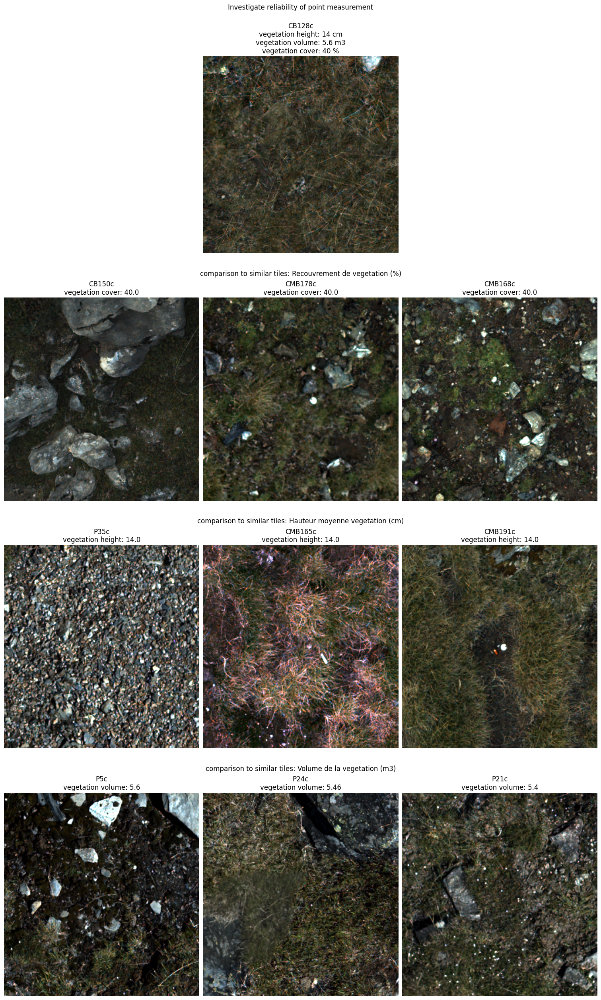

In [120]:
# qc check II: plot each tile + three similarly labelled ones
def qc_check_II(tile_name, save=False):
    # get tile path & measurements 
    tile = os.path.join(all_tiles_dir, tile_name)
    tile_meas = point_meas[point_meas["JETON"] == os.path.split(tile)[-1].split(".tif")[0]]
    # create fig
    fig = plt.figure(figsize=(15,5*len(h_intervals)), constrained_layout=True)
    fig.suptitle('Investigate reliability of point measurement')
    row_vars = ["self", "Recouvrement de vegetation (%)", "Hauteur moyenne vegetation (cm)", "Volume de la vegetation (m3)"]
    subfigs = fig.subfigures(nrows=len(row_vars), ncols=1)
    # create figure
    for row, subfig in enumerate(subfigs):
        # get tiles for each row
        var = row_vars[row]
        if var == "self":
            tiles_ = tile_meas["JETON"]
            tiles_ = [os.path.join(all_tiles_dir, f"{x}.tif") for x in tiles_]
            # plot tile to be investigated
            axs = subfig.subplots(nrows=1, ncols=3)
            for col, ax in enumerate(axs):
                if col == 1:
                    # get imagery
                    rgb = plot_tiles(tiles_[0])
                    ax.imshow(np.transpose(rgb, (1,2,0)), aspect="auto")
                    # get corresponding stats
                    site = os.path.split(tiles_[0])[-1].split(".tif")[0]
                    stat_h = int(point_meas[point_meas["JETON"] == site]["Hauteur moyenne vegetation (cm)"])
                    stat_r = int(point_meas[point_meas["JETON"] == site]["Recouvrement de vegetation (%)"])
                    stat_v = float(point_meas[point_meas["JETON"] == site]["Volume de la vegetation (m3)"])
                    ax.set_title(
                        f"\n"
                        f"{site}\n"
                        f"vegetation height: {stat_h} cm\n"
                        f"vegetation volume: {stat_v} m3\n"
                        f"vegetation cover: {stat_r} %"
                    )
                ax.set_axis_off()
        else:
            subfig.suptitle(f'\ncomparison to similar tiles: {var}')
            point_meas_ = point_meas.drop(index=tile_meas.index)
            point_meas_["diff"] = [np.abs(x - float(tile_meas[var])) for x in point_meas_[var]]
            tiles_ = point_meas_.sort_values("diff").head(3)["JETON"]
            tiles_ = [os.path.join(all_tiles_dir, f"{x}.tif") for x in tiles_]
            # plot similarly labelled tiles as a reference
            axs = subfig.subplots(nrows=1, ncols=3)
            for col, ax in enumerate(axs):
                # get imagery
                rgb = plot_tiles(tiles_[col])
                ax.imshow(np.transpose(rgb, (1,2,0)), aspect="auto")
                # get corresponding stats
                site = os.path.split(tiles_[col])[-1].split(".tif")[0]
                stat = float(point_meas[point_meas["JETON"] == site][var])
                ax.set_title(
                    f"{site}\n"
                    f"{var_mapping[var]}: {stat}"
                )
                ax.set_axis_off()
    # save figure
    if save:
        save_dir = os.path.join(fig_dir, "reliability_check")
        os.makedirs(save_dir, exist_ok=True)
        fig.savefig(os.path.join(save_dir, f"{tile_name.split('.tif')[0]}.png"))
        plt.close()

qc_check_II('CB128c.tif')

In [121]:
# perform qc check II for all tiles
for tile in tqdm(os.listdir(all_tiles_dir)):
    qc_check_II(tile, save=True)

100%|██████████| 187/187 [07:15<00:00,  2.33s/it]


In [7]:
# compile unreliable tiles based on manual investigation
# plot questionable tiles

unreliable = [
    "P10c", "P12c", "P13c", "P20c", "P35c", "P37c", 
    "CB41c", "CB43c", "CB128c", "CB145c", "CB146c", "CB149c", "CB196c", "CB200c",
    "CMB156c", "CMB157c", "CMB170c", "CMB175c", "CMB178c", 
    "CMH71c", "CMH72c", "CMH116c", 
    "CH38c", "CH40c", "CH42c", "CH53c", "CH55c"
]

qc_check_I(
    df = point_meas[point_meas["JETON"].isin(unreliable)],
    var = "Recouvrement de vegetation (%)", 
    reclass_schema = [[0,25], [25,50], [50,75], [75,100]],
    vis = "rgb",
    save = True,
    save_name = "point_tiles_unreliable_rgb.png"
    )

In [9]:
# to-do: delete biomasses_backup.csv which is the first version of unreliable tiles
# filter unreliable tiles (also flagged in biomass.csv)
point_meas = point_meas[~point_meas["JETON"].isin(unreliable)]
point_meas.to_csv(os.path.join(point_tiles_dir, "meas_tiles.csv"), index=False)

rm_count = 0
for x in os.listdir(all_tiles_dir):
    if x.split(".tif")[0] not in list(point_meas["JETON"]):
        os.remove(os.path.join(all_tiles_dir, x)) 
        rm_count += 1

print(f"A total of {rm_count} tiles was removed as they were flagged as unreliable measurements.")

point_meas.head(5)

A total of 160 tiles was removed as they were flagged as unreliable measurements.


,JETON,SITE,NUM_POINT,LETTRE_POINT,X,Y,Z,BiomiV ((1/16)g/m2),BiomiL ((1/16)g/m2),BiomiTot ((1/16)g/m2),BiomiTot16 (g/m2),BiomfV ((1/16)g/m2),BiomfL ((1/16)g/m2),BiomfTot ((1/16)g/m2),BiomfTot16 (g/m2),Hauteur moyenne vegetation (cm),Volume de la vegetation (m3),Recouvrement de vegetation (%),geometry
40,P1c,La_Plagne,1,c,1531089.022,2182496.772,1094.0727,6.506,0.621,7.127,114.032,2.158,0.441,2.599,41.584,4.0,1.00,25.0,POINT (1531089.022 2182496.772)
41,P2c,La_Plagne,2,c,1531084.701,2182496.741,1093.3000,1.110,1.313,2.423,38.768,6.669,5.085,11.754,188.064,30.0,22.50,75.0,POINT (1531084.701 2182496.741)
42,P3c,La_Plagne,3,c,1531076.582,2182497.949,1092.4916,0.001,0.000,0.000,0.000,0.010,0.000,0.010,0.160,2.0,0.02,1.0,POINT (1531076.582 2182497.949)
43,P4c,La_Plagne,4,c,1531069.226,2182499.654,1091.5964,0.001,0.000,0.000,0.000,0.010,0.000,0.010,0.160,1.0,0.01,1.0,POINT (1531069.226 2182499.654)
44,P5c,La_Plagne,5,c,1531062.348,2182498.724,1090.5307,1.494,4.243,5.737,91.792,3.035,0.679,3.714,59.424,7.0,5.60,80.0,POINT (1531062.348 2182498.724)


In [155]:
# plotting I: all tiles which are used for further analyses
qc_check_I(
    df = point_meas,
    var = "Recouvrement de vegetation (%)", 
    reclass_schema = [[0,25], [25,50], [50,75], [75,100]],
    vis = "rgb",
    save = True,
    save_name = "point_tiles_rgb.png"
    )

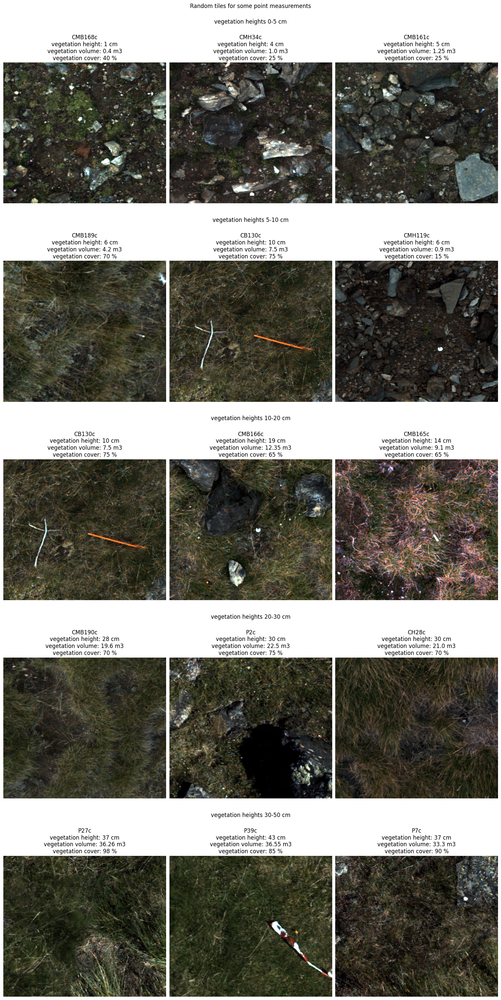

In [159]:
# plotting II: random selection of some tiles
# explorative analyses of tiles & point measurements
h_intervals = [[0,5], [5,10], [10,20], [20,30], [30,50]]
rows = len(h_intervals)
n_examples = 3

# create fig
fig = plt.figure(figsize=(15,6*len(h_intervals)), constrained_layout=True)
fig.suptitle('Random tiles for some point measurements')
subfigs = fig.subfigures(nrows=rows, ncols=1)

# subfigure row per vegetation height interval
for row, subfig in enumerate(subfigs):
    subfig.suptitle(f'\nvegetation heights {h_intervals[row][0]}-{h_intervals[row][1]} cm')
    heights = h_intervals[row]
    meas_heights = point_meas[point_meas['Hauteur moyenne vegetation (cm)'].between(heights[0], heights[1])].reset_index()

    rand_idxs = np.random.randint(len(meas_heights), size=len(meas_heights))
    tiles = []
    for idx in rand_idxs:
        tile_path = os.path.join(all_tiles_dir, f"{meas_heights.iloc[idx,:]['JETON']}.tif")
        if os.path.exists(tile_path):
            tiles.append(tile_path)
            if len(tiles) == n_examples:
                break

    # plot examples
    axs = subfig.subplots(nrows=1, ncols=n_examples)
    for col, ax in enumerate(axs):
        # get imagery
        rgb = plot_tiles(tiles[col])
        ax.imshow(np.transpose(rgb, (1,2,0)), aspect="auto")
        # get corresponding stats
        site = os.path.split(tiles[col])[-1].split(".tif")[0]
        stat_h = int(point_meas[point_meas["JETON"] == site]["Hauteur moyenne vegetation (cm)"])
        stat_r = int(point_meas[point_meas["JETON"] == site]["Recouvrement de vegetation (%)"])
        stat_v = float(point_meas[point_meas["JETON"] == site]["Volume de la vegetation (m3)"])
        ax.set_title(
            f"\n{site}\n"
            f"vegetation height: {stat_h} cm\n"
            f"vegetation volume: {stat_v} m3\n"
            f"vegetation cover: {stat_r} %"
        )
        ax.set_axis_off()

plt.show();

## Part IIc: Explorative analyses on point measurements 

In [ ]:
# tbd
    # spatial correlations -> variograms
        # if sampling random -> based on point measurements
        # else based on spectral values (NDVI, etc)
    # srcs
        # https://scikit-gstat.readthedocs.io/en/latest/userguide/variogram.html
        # https://geostat-framework.readthedocs.io/projects/pykrige/en/latest/examples/07_regression_kriging2d.html#sphx-glr-examples-07-regression-kriging2d-py

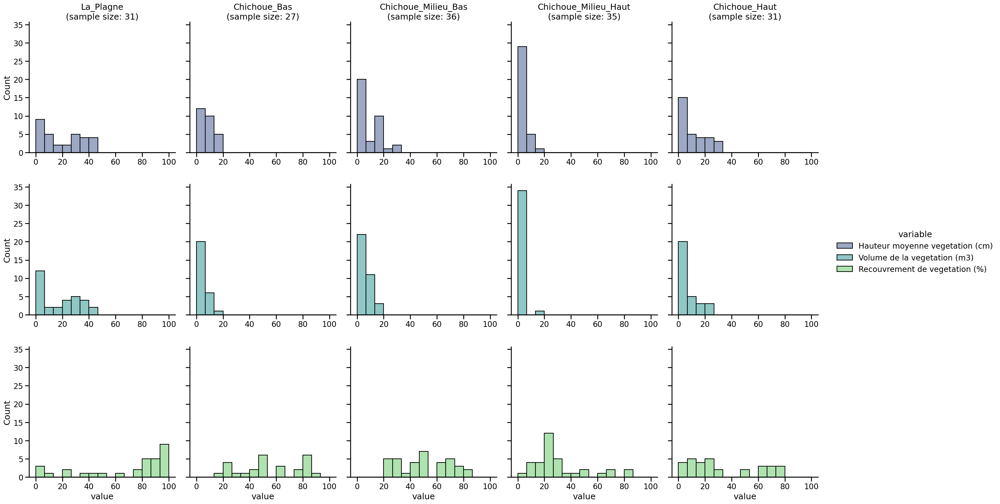

In [174]:
# variability of in-situ-measurements
in_situ_plot = pd.melt(
    point_meas, 
    id_vars=['JETON', 'SITE'], 
    value_vars=[
        "Hauteur moyenne vegetation (cm)", 
        "Volume de la vegetation (m3)",
        "Recouvrement de vegetation (%)"]
    )

sns.set_context("talk")
fig = sns.displot(
    data=in_situ_plot, 
    x="value",
    hue = "variable", 
    col="SITE",  
    row="variable", 
    palette="viridis",
    facet_kws=dict(sharex=False)
    )

for col in range(0,fig.axes.shape[1]):
    site = fig.axes[0][col].title.get_text().split("= ")[-1]
    n = len(point_meas[point_meas["SITE"] == site])
    fig.axes[0][col].set_title(f"{site}\n(sample size: {n})")
    fig.axes[1][col].set_title("")
    fig.axes[2][col].set_title("")

fig.savefig(os.path.join(fig_dir, "biomass_eda.png"))

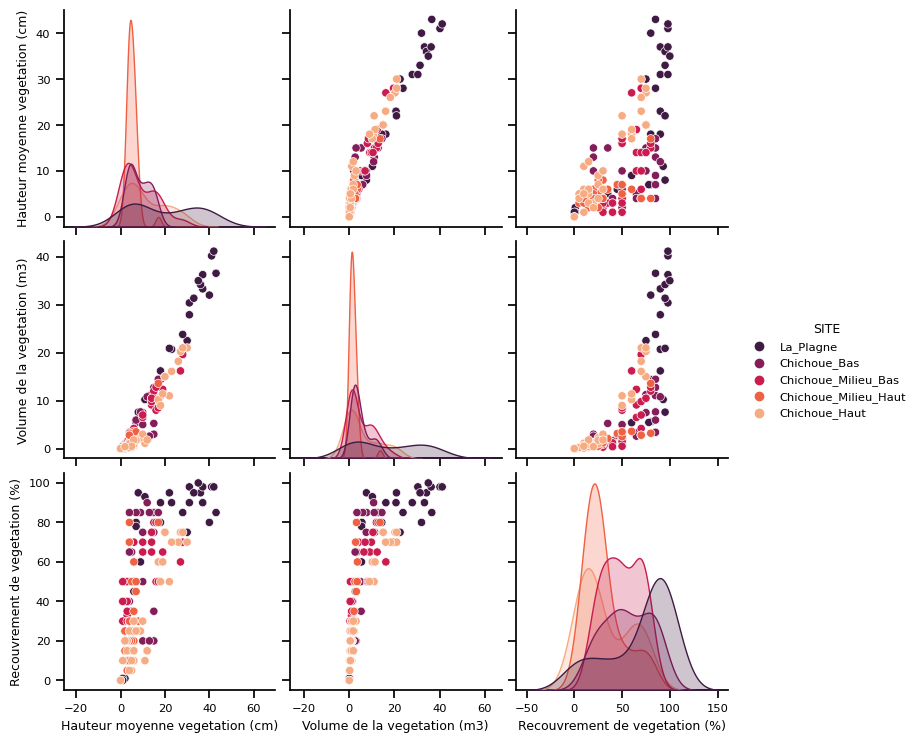

In [178]:
# relationship between variables
sns.set_context("notebook", font_scale=0.75)
in_situ_plot = point_meas[
    ["JETON", 
    "SITE", 
    "Hauteur moyenne vegetation (cm)", 
    "Volume de la vegetation (m3)",
    "Recouvrement de vegetation (%)"]
    ]

fig = sns.pairplot(
    in_situ_plot,
    hue = "SITE",
    palette = "rocket"
    )

fig.savefig(os.path.join(fig_dir, "biomass_eda_II.png"))

# improve labels
# print(fig.axes[1][0].xaxis.get_label().get_text())
# print(fig.axes[1][0].yaxis.get_label().get_text())

# import textwrap
# def wrap_labels(ax, width, break_long_words=False):
#     labels = []
#     for label in ax.xaxis.get_labels():
#         text = label.get_text()
#         labels.append(textwrap.fill(text, width=width,
#                       break_long_words=break_long_words))
#     ax.set_xlabel(labels, rotation=0)

## Part IId: Train-Val-Test split

In [ ]:
# note: see seperate script tsne_data_synthesis.py

In [84]:
# divide tiles into train/val/test
# define dirs
train_cnn = os.path.join(point_tiles_dir, "train")
val_cnn = os.path.join(point_tiles_dir, "val")
test_cnn = os.path.join(point_tiles_dir, "test")

for fold in [train_cnn, val_cnn, test_cnn]:
    os.makedirs(fold)

tiles = [x for x in os.listdir(all_tiles_dir) if x[:3]!="CMB"]
split_ratio = np.array([0.7, 0.15, 0.15])

sites = [''.join(x for x in t if not x.isdigit()).split(".tif")[0] for t in tiles]
tiles_df = pd.DataFrame({"tiles":tiles, "sites":sites})
n_samples = len(tiles_df)

for frac,portion in zip(split_ratio, ["train", "val", "test"]):
    # draw samples & assign to portion
    p = (frac * n_samples) / len(tiles_df)
    p = p if p <= 1 else 1
    tiles_samples = tiles_df.groupby("sites").sample(frac=p)
    for i, row in tiles_samples.iterrows():
        shutil.copy(os.path.join(all_tiles_dir, row["tiles"]), os.path.join(locals()[f"{portion}_cnn"]))
    # exclude drawn samples from pool of tiles
    idxs = [x for x in tiles_df.index if x not in tiles_samples.index]
    tiles_df = tiles_df.loc[idxs,:]

# get final split ratio
actual_split = np.array([
    len(os.listdir(train_cnn))/len(tiles),
    len(os.listdir(val_cnn))/len(tiles),
    len(os.listdir(test_cnn))/len(tiles)
])

# get count per site
train_t, val_t, test_t = os.listdir(train_cnn), os.listdir(val_cnn), os.listdir(test_cnn)
site_count = []

for set in [train_t, val_t, test_t]:
    sites = [''.join(x for x in t if not x.isdigit()).split(".tif")[0] for t in set]
    site_c = pd.Series(sites).value_counts()
    site_count.append(site_c)

site_count = pd.concat(site_count, axis=1)
site_count = site_count.rename(columns = {0:"train", 1:"val", 2:"test"})

print(f"final split ratio (test-val-train): {actual_split[0]:.0%}-{actual_split[1]:.0%}-{actual_split[2]:.0%}")
print(f"final distribution across sites:\n{site_count}")

final split ratio (test-val-train): 70%-15%-14%
final distribution across sites:
      train  val  test
Pc       21    5     4
CHc      20    4     4
CBc      19    4     4
CMHc     18    4     4


In [13]:
# prepare required folder structure for dataloader
# define dirs
height_cnn = os.path.join(point_tiles_dir, "height")
volume_cnn = os.path.join(point_tiles_dir, "volume")
coverage_cnn = os.path.join(point_tiles_dir, "coverage")

for set in [train_cnn, val_cnn, test_cnn]:
    set_name = os.path.split(set)[-1]
    for tile in os.listdir(set):
        jeton = tile.split(".tif")[0]
        in_situ_meas = point_meas[point_meas["JETON"]==jeton]
        dir_1 = os.path.join(height_cnn, set_name, str(float(in_situ_meas["Hauteur moyenne vegetation (cm)"])))
        dir_2 = os.path.join(volume_cnn, set_name, str(float(in_situ_meas["Volume de la vegetation (m3)"])))
        dir_3 = os.path.join(coverage_cnn, set_name, str(float(in_situ_meas["Recouvrement de vegetation (%)"])))
        os.makedirs(dir_1, exist_ok=True)
        os.makedirs(dir_2, exist_ok=True)
        os.makedirs(dir_3, exist_ok=True)
        shutil.copy(os.path.join(set, tile), os.path.join(dir_1))
        shutil.copy(os.path.join(set, tile), os.path.join(dir_2))
        shutil.copy(os.path.join(set, tile), os.path.join(dir_3))
    shutil.rmtree(set)